### Notebook for the integration of adult stem cells (Elmentaite, 2021; Wang, 2019; Kong, 2022; Smillie, 2021)
- **Developed by:** Anna Maguza
- **Place:** Wuerzburg Institute for System Immunology
- **Date:** 8th April 2024

In [34]:
import scvi
import torch
import anndata
import warnings
import numpy as np
import scanpy as sc
import pandas as pd
import plotnine as p
from pywaffle import Waffle
import matplotlib.pyplot as plt

##### Setup working environment

In [35]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'magma_r', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.10.3
scanpy      1.9.6
-----
PIL                         10.1.0
absl                        NA
aiohttp                     3.8.6
aiosignal                   1.3.1
annotated_types             0.6.0
anyio                       NA
arrow                       1.3.0
asttokens                   NA
async_timeout               4.0.3
attr                        23.1.0
attrs                       23.1.0
babel                       2.13.1
backoff                     2.2.1
brotli                      1.1.0
bs4                         4.12.2
certifi                     2023.07.22
cffi                        1.16.0
charset_normalizer          3.3.2
chex                        0.1.7
click                       8.1.7
colorama                    0.4.6
comm                        0.1.4
contextlib2                 NA
croniter                    NA
cycler                      0.12.1
cython_runtime              NA
dateutil                    2.8.2
debugpy                     1.8.0
decor

In [36]:
warnings.simplefilter(action = 'ignore')
scvi.settings.seed = 1712
%config InlineBackend.print_figure_kwargs = {'facecolor' : "w"}
%config InlineBackend.figure_format = 'retina'
torch.set_float32_matmul_precision('medium')

Global seed set to 1712


In [37]:
arches_params = dict(
    use_layer_norm = "both",
    use_batch_norm = "none",
    encode_covariates = True,
    dropout_rate = 0.2,
    n_layers = 3,
)

In [38]:
def X_is_raw(adata):
    return np.array_equal(adata.X.sum(axis=0).astype(int), adata.X.sum(axis=0))

#### Read in data

In [39]:
adata = sc.read_h5ad("/mnt/LaCIE/annaM/gut_project/Processed_data/Gut_data/Healthy_reference/Integrated/Integrated_4_datasets_05042024.h5ad")

In [40]:
X_is_raw(adata)

True

In [41]:
adata_raw = adata.copy()

#### Extract Stem cells

In [42]:
stem_cells = ['Stem cells OLFM4', 'Stem cells OLFM4 GSTA1', 'Stem cells OLFM4 LGR5', 'Stem cells OLFM4 PCNA', 'Stem_Cells_GCA', 'Stem_Cells_ext']
adata = adata[adata.obs['Cell States'].isin(stem_cells), :]

In [43]:
adata.obs['Diagnosis'].value_counts()

Healthy adult                            26628
Fetal Healthy                             7817
Adult Ulcerative Colitis Non-inflamed     1030
Pediatric healthy                          353
Name: Diagnosis, dtype: int64

In [44]:
adult = ['Healthy adult', 'Adult Ulcerative Colitis Non-inflamed']
adata = adata[adata.obs['Diagnosis'].isin(adult), :]

In [45]:
adata.obs['Cell States'].value_counts()

Stem cells OLFM4          17874
Stem cells OLFM4 LGR5      7876
Stem_Cells_GCA              826
Stem cells OLFM4 PCNA       700
Stem cells OLFM4 GSTA1      341
Stem_Cells_ext               41
Name: Cell States, dtype: int64

In [46]:
adata.obs['Cell States'] = adata.obs['Cell States'].cat.add_categories(['Unknown'])

adata.obs.loc[(adata.obs['Cell States'] == 'Stem_Cells_ext'), 'Cell States'] = 'Unknown'
adata.obs.loc[(adata.obs['Cell States'] == 'Stem_Cells_GCA'), 'Cell States'] = 'Unknown'

#### Extract Highly Variable Genes

In [47]:
adata.layers['counts'] = adata.X.copy()

In [48]:
# Calculate 3000 HVGs
sc.pp.highly_variable_genes(
    adata,
    flavor = "seurat_v3",
    n_top_genes = 7000,
    layer = "counts",
    batch_key = "Library_Preparation_Protocol",
    subset = True,
    span = 1
)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


#### Integrate with scVI

In [49]:
scvi.model.SCVI.setup_anndata(adata, 
                              categorical_covariate_keys=['Sample_ID', 'Donor_ID', 
                                                          'Library_Preparation_Protocol', 
                                                          'Study_name'],
                            labels_key = "Cell States", 
                            layer = 'counts')

In [50]:
scvi_model = scvi.model.SCVI(adata,
                            n_latent = 50, 
                            n_layers = 3, 
                            dispersion = 'gene-batch', 
                            gene_likelihood = 'nb')

In [51]:
scvi_model.train(50, 
                 check_val_every_n_epoch = 1, 
                 enable_progress_bar = True, 
                 accelerator = "gpu",
                 devices = [0])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Epoch 50/50: 100%|█| 50/50 [01:07<00:00,  1.41s/it, v_num=1, train_loss_step=1.64e+3, train_loss_e

`Trainer.fit` stopped: `max_epochs=50` reached.


Epoch 50/50: 100%|█| 50/50 [01:07<00:00,  1.34s/it, v_num=1, train_loss_step=1.64e+3, train_loss_e


In [52]:
adata.obsm['X_scvi'] = scvi_model.get_latent_representation()

#### Evaluate model performance using the [_Svensson_](https://www.nxn.se/valent/2023/8/10/training-scvi-posterior-predictive-distributions-over-epochs) method

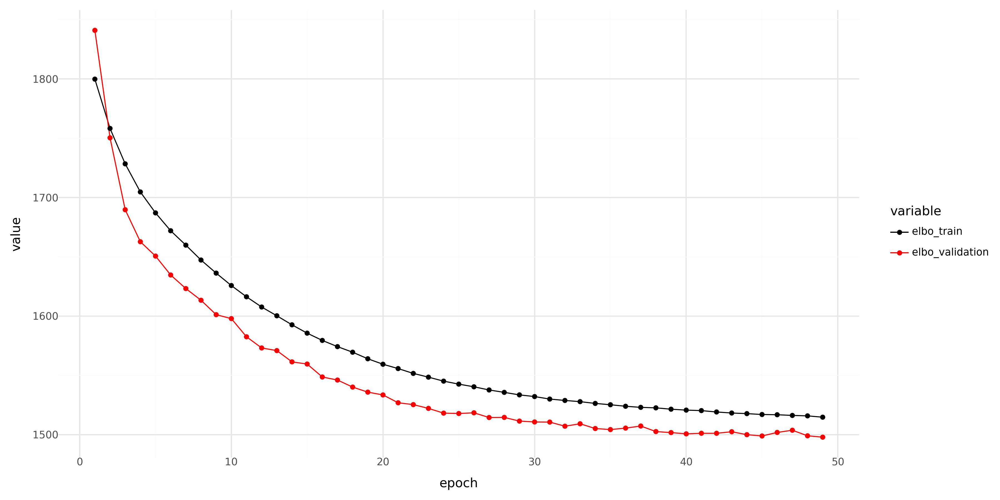

In [53]:
history_df = (
    scvi_model.history['elbo_train'].astype(float)
    .join(scvi_model.history['elbo_validation'].astype(float))
    .reset_index()
    .melt(id_vars = ['epoch'])
)

p.options.figure_size = 12, 6

p_ = (
    p.ggplot(p.aes(x = 'epoch', y = 'value', color = 'variable'), history_df.query('epoch > 0'))
    + p.geom_line()
    + p.geom_point()
    + p.scale_color_manual({'elbo_train': 'black', 'elbo_validation': 'red'})
    + p.theme_minimal()
)

print(p_)

#### Integration with scANVI

In [54]:
scanvi_model = scvi.model.SCANVI.from_scvi_model(scvi_model, 'Unknown')

In [55]:
scanvi_model.train(35, 
                   check_val_every_n_epoch = 1, 
                   enable_progress_bar = True,
                   accelerator = "gpu",
                   devices = [0])

INFO     Training for 35 epochs.                                                                                   


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Epoch 35/35: 100%|█| 35/35 [02:12<00:00,  3.49s/it, v_num=1, train_loss_step=1.3e+3, train_loss_ep

`Trainer.fit` stopped: `max_epochs=35` reached.


Epoch 35/35: 100%|█| 35/35 [02:12<00:00,  3.77s/it, v_num=1, train_loss_step=1.3e+3, train_loss_ep


In [56]:
adata.obs["C_scANVI"] = scanvi_model.predict(adata)

### Explore model performance using the [_Svensson_](https://www.nxn.se/valent/2023/8/10/training-scvi-posterior-predictive-distributions-over-epochs) method

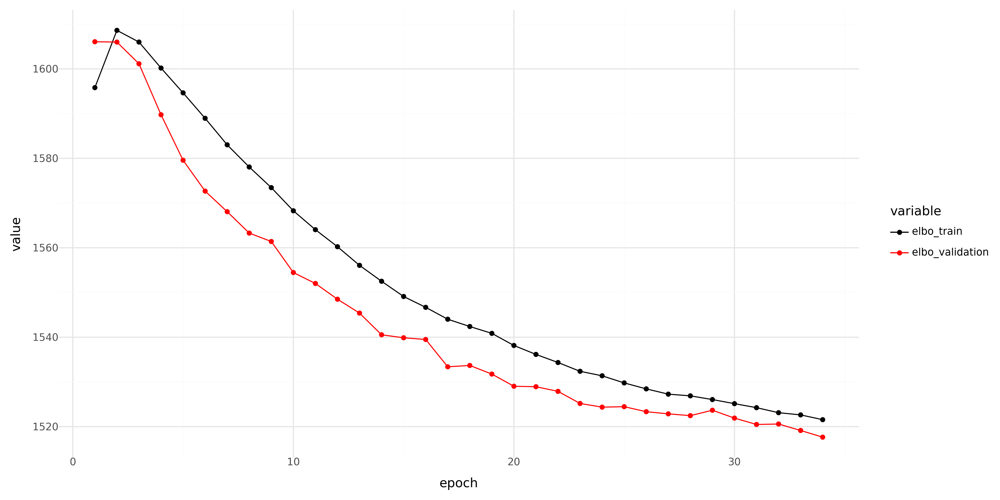

In [57]:
history_df = (
    scanvi_model.history['elbo_train'].astype(float)
    .join(scanvi_model.history['elbo_validation'].astype(float))
    .reset_index()
    .melt(id_vars = ['epoch'])
)

p.options.figure_size = 12, 6

p_ = (
    p.ggplot(p.aes(x = 'epoch', y = 'value', color = 'variable'), history_df.query('epoch > 0'))
    + p.geom_line()
    + p.geom_point()
    + p.scale_color_manual({'elbo_train': 'black', 'elbo_validation': 'red'})
    + p.theme_minimal()
)

p_.save('fig1.png', dpi = 300)

print(p_)

- Extract latent representation

In [58]:
adata.obsm["X_scANVI"] = scanvi_model.get_latent_representation(adata)

+ Visualize dataset

In [59]:
sc.pp.neighbors(adata, use_rep = "X_scANVI", n_neighbors = 50, metric = 'minkowski')
sc.tl.umap(adata, min_dist = 0.2, spread = 2, random_state = 1712)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


In [60]:
adata.obs

,Sample_ID,Cell Type,Study_name,Donor_ID,Diagnosis,Age,Region code,Fraction,Gender,Library_Preparation_Protocol,...,n_genes_by_counts,total_counts,total_counts_mito,pct_counts_mito,total_counts_ribo,pct_counts_ribo,Cell_ID,_scvi_batch,_scvi_labels,C_scANVI
cell_id,,,,,,,,,,,,,,,,,,,,,
AACACGTTCTTGCATT_Ileum-1_Stem Cell,Ileum-1,Stem Cell,Wang,Wang_Donor_1,Healthy adult,nan,nan,nan,nan,nan,...,3075,15733.0,2722.0,17.301214,5100.0,32.415943,AACACGTTCTTGCATT_Ileum-1_Stem Cell,0,0,Stem cells OLFM4
AACCGCGCATGAAGTA_Ileum-1_Stem Cell,Ileum-1,Stem Cell,Wang,Wang_Donor_1,Healthy adult,nan,nan,nan,nan,nan,...,2782,13928.0,2136.0,15.336015,5261.0,37.772831,AACCGCGCATGAAGTA_Ileum-1_Stem Cell,0,2,Stem cells OLFM4 LGR5
AACTCAGAGCGATCCC_Ileum-1_Stem Cell,Ileum-1,Stem Cell,Wang,Wang_Donor_1,Healthy adult,nan,nan,nan,nan,nan,...,1878,6978.0,702.0,10.060189,2716.0,38.922329,AACTCAGAGCGATCCC_Ileum-1_Stem Cell,0,0,Stem cells OLFM4
AACTCCCTCTCAACTT_Ileum-1_Stem Cell,Ileum-1,Stem Cell,Wang,Wang_Donor_1,Healthy adult,nan,nan,nan,nan,nan,...,3718,19378.0,2263.0,11.678192,7129.0,36.789143,AACTCCCTCTCAACTT_Ileum-1_Stem Cell,0,0,Stem cells OLFM4
AACTCTTAGCTTCGCG_Ileum-1_Stem Cell,Ileum-1,Stem Cell,Wang,Wang_Donor_1,Healthy adult,nan,nan,nan,nan,nan,...,3498,21237.0,4083.0,19.225880,7718.0,36.342232,AACTCTTAGCTTCGCG_Ileum-1_Stem Cell,0,0,Stem cells OLFM4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
H180844_N4-CGTTCTGGTGTTGGGA,H180844_N4,Stem Cell,Kong 2023,180844,Healthy adult,NaN,NaN,NaN,Male,10x 3' v2,...,213,317.0,43.0,13.564669,60.0,18.927444,H180844_N4-CGTTCTGGTGTTGGGA,0,0,Stem cells OLFM4
H180844_N4-CCACTACTCCAAGTAC,H180844_N4,Stem Cell,Kong 2023,180844,Healthy adult,NaN,NaN,NaN,Male,10x 3' v2,...,212,309.0,41.0,13.268608,64.0,20.711975,H180844_N4-CCACTACTCCAAGTAC,0,0,Stem cells OLFM4
H180844_N4-AGTGGGAAGGCAAAGA,H180844_N4,Stem Cell,Kong 2023,180844,Healthy adult,NaN,NaN,NaN,Male,10x 3' v2,...,234,308.0,8.0,2.597403,37.0,12.012987,H180844_N4-AGTGGGAAGGCAAAGA,0,0,Stem cells OLFM4


In [61]:
sc.set_figure_params(dpi = 300, figsize=(10,10))
sc.pl.umap(adata, color = ['Cell States', 'C_scANVI', 'Study_name', 'Library_Preparation_Protocol', 'Donor_ID'], ncols = 4, frameon = False, size = 8)

#### Export the dataset

In [62]:
adata

AnnData object with n_obs × n_vars = 27658 × 7000
    obs: 'Sample_ID', 'Cell Type', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', 'Library_Preparation_Protocol', 'batch', 'Age_group', 'Location', 'Cell States', 'Cell States GCA', 'Chem', 'Layer', 'Cell States Kong', 'dataset', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'pct_counts_ribo', 'Cell_ID', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_id-query', 'gene_name-query', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'ribo', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'Cell Type_colors', 'Donor_ID_colors', 'Library_Preparation_Protocol_colors', 'Study_name_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'neighbors', 'umap', 'Cell States_colors', 'C_scANVI_colors'
    obsm: '

In [63]:
adata_raw

AnnData object with n_obs × n_vars = 557099 × 23616
    obs: 'Sample_ID', 'Cell Type', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', 'Library_Preparation_Protocol', 'batch', 'Age_group', 'Location', 'Cell States', 'Cell States GCA', 'Chem', 'Layer', 'Cell States Kong', 'dataset', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'pct_counts_ribo', 'Cell_ID', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_id-query', 'gene_name-query', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'ribo'
    uns: 'Cell Type_colors', 'Donor_ID_colors', 'Library_Preparation_Protocol_colors', 'Study_name_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'neighbors', 'umap'
    obsm: 'X_scANVI', 'X_scvi', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    obsp: 'connectivities', 'distances'

In [64]:
adata_raw = adata_raw[adata.obs_names, :].copy()

In [65]:
adata_export = anndata.AnnData(X = adata_raw.X, obs = adata.obs, var = adata_raw.var, uns = adata.uns, obsm = adata.obsm, obsp = adata.obsp)

In [66]:
adata_export

AnnData object with n_obs × n_vars = 27658 × 23616
    obs: 'Sample_ID', 'Cell Type', 'Study_name', 'Donor_ID', 'Diagnosis', 'Age', 'Region code', 'Fraction', 'Gender', 'Library_Preparation_Protocol', 'batch', 'Age_group', 'Location', 'Cell States', 'Cell States GCA', 'Chem', 'Layer', 'Cell States Kong', 'dataset', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'pct_counts_ribo', 'Cell_ID', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_id-query', 'gene_name-query', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mito', 'ribo'
    uns: 'Cell Type_colors', 'Donor_ID_colors', 'Library_Preparation_Protocol_colors', 'Study_name_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'neighbors', 'umap', 'Cell States_colors', 'C_scANVI_colors'
    obsm: 'X_scANVI', 'X_scvi', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    obsp: 'connec

In [67]:
adata_export.write_h5ad("/mnt/LaCIE/annaM/gut_project/Processed_data/Gut_data/Healthy_reference/Integrated/Adult_stem_cells_integrated_08042024.h5ad")